In [1]:
import numpy as np
import pickle
import os
import matplotlib.pyplot as plt
from scipy.stats import sem
import scipy.stats as stats
import math
from lmfit import Model
from pymatgen.core.periodic_table import Element
from scipy import constants as const
from matplotlib import rc
from statistics import mean

vol, press, press2, pres_std, pres_ci = [],[],[],[], []
press2 = []
press = []

In [2]:
def read_lattice(fileobject):
    """Read the lattice from the next lines in a file object.

    :param fileobject:
    """
    lat_arr = []
    for iline in range(3):
        latline = next(fileobject).split()[:3]
        try:
            lat_arr.append([float(t) for t in latline])
        except:
            newlatline = []
            for lnum in range(len(latline)):
                # lattice number
                ln = latline[lnum]
                negsigns = [m.start() for m in re.finditer('-', ln)]
                if len(negsigns) >= 2:
                    negsigns.append(len(ln))
                    subn =[]
                    for ns in range(len(negsigns[:-1])):
                        subn.append(ln[negsigns[ns]:negsigns[ns+1]])
                    for sn in reversed(subn):
                        newlatline.append(sn)
                else:
                    newlatline.append(ln)
                if len(newlatline) == 3:
                    break
            lat_arr.append([float(t) for t in newlatline])
    lat_arr=np.array(lat_arr)

    return lat_arr



def read_atoms(fileobject,nions):
    """Read the atomic positions from the next lines.
    :param fileobject:
    :param int nions:
    """
    return np.array([[float(t) for t in next(fileobject).split()[:3]] for iline in range(nions)])


def read_atoms_forces(fileobject,nions):
    """Read atoms and forces from the next lines.
    :param fileobject:
    :param int nions:
    """
    # First line is dashes
    next(fileobject)
    data = np.array([[float(t) for t in next(fileobject).split()] for iline in range(nions)])
    return data[:,:3], data[:,3:]


def outcar_read(fileobject):
    """Read an OUTCAR to extract data.
    :param filestream fileobject: File to read, positioned at the beginning.
    :rtype: dict
    :returns: Dictionary of data read, with these keys:
        * ``lattice``: *(float T,3,3)* Lattice parameters.
        * ``cell volume``: *(float T,)* volume of the simulation cell
        * ``atoms``: *(float T,N,3)* Atomic positions, Cartesian coordinates.
        * ``forces``: *(float T,N,3)* Atomic forces, Cartesian coordinates.
        * ``free energy``: *(float T,)* Free energy.
        * ``kinetic energy``: *(float T,)* Kinetic energy.
        * ``temperature``: *(float T,)* Temperature.
        * ``total pressure : *(float, T,)* total pressure on the system
        * ``external pressure : *(float T,)* external pressure on the system
        * ``nose potential``: *(float T,)* Potential energy of the thermostat.
        * ``nose kinetic``: *(float T,)* Kinetic energy of the thermostat.
        * ``total energy``: *(float T,)* Total energy of the system.
        * ``version``: VASP version.
        * ``NKPTS, NKDIM, NBANDS, NEDOS, NIONS``, etc.: VASP parameters in the OUTCAR header.
        * ``step``: Step number; only applicable if they are not every step.
    """
    data = {key: [] for key in ['lattice','cell volume','atoms','forces','stresses','free TOTEN','free energy','kinetic energy','temperature','nose potential','nose kinetic','total energy','external pressure', 'total pressure', 'energy without entropy']}
    data['version'] = next(fileobject)
    line = next(fileobject)
    # Read run info
    while 'Dimension of arrays' not in line:
        line = next(fileobject)
    line = next(fileobject)
    data['NKPTS'], data['NKDIM'], data['NBANDS'] = [int(line.split()[i]) for i in [3,9,14] ]
    line = next(fileobject)
    data['NEDOS'], data['NIONS'] = [int(line.split()[i]) for i in [5,11] ]
    while 'Ionic relaxation' not in line:
        line = next(fileobject)
    while 'Mass of Ions' not in line:
        line = next(fileobject)
        if line.count('=')!=1:
            continue
        tag,value = line.split('=')
        try:
            data[tag.strip()] = float(value.split()[0])
        except ValueError:
            data[tag.strip()] = value.strip()
    try:
        while True:
            # Go to converged value
            while 'aborting loop' not in line:
                line = next(fileobject)
            while 'external pressure' not in line:
                line = next(fileobject)
            data['external pressure'].append(float(line.split()[3]))
            for _ in range(3):
                line = next(fileobject)

            try:
                data['total pressure'].append(float(line.split()[-2]))
            except:
                pass
            while 'volume of cell' not in line:
                line = next(fileobject)
            data['cell volume'].append(float(line.split()[-1]))
            while 'direct lattice vectors' not in line:
                line = next(fileobject)
            data['lattice'].append(read_lattice(fileobject))
            while 'TOTAL-FORCE' not in line:
                line = next(fileobject)
            #atoms, forces = read_atoms_forces(fileobject,data['NIONS'])
            #data['atoms'].append(atoms)
            #data['forces'].append(forces)
            while 'Iteration' not in line:
                line = next(fileobject)
                if 'FREE ENERGIE' in line:
                    print((next(fileobject).split()))
                    #for _ in range(1):
                    #    line = next(fileobject)
                    data['free TOTEN'].append(float(next(fileobject).split()[-2]))
                    #print(fileobject)
                    for _ in range(1):
                        line = next(fileobject)
                    data['free energy'].append(float(next(fileobject).split()[-1]))
                    #print(next(fileobject).split())
                elif 'ELECTRON-ION-THERMOSTAT' in line:
                    for i in range(2):
                        next(fileobject)
                    data['kinetic energy'].append(float(next(fileobject).split()[-1]))
                    tempstr = next(fileobject).split()[-2].strip('(temperature')
                    try:
                        data['temperature'].append(float(tempstr))
                    except:
                        pass
                    data['nose potential'].append(float(next(fileobject).split()[-1]))
                    data['nose kinetic'].append(float(next(fileobject).split()[-1]))
                    next(fileobject)
                    data['total energy'].append(float(next(fileobject).split()[-2]))
                    
    except StopIteration:
        pass

    for key in list(data.keys()):
        if hasattr(data[key],'__len__') and not len(data[key]):
            del data[key]
        elif hasattr(data[key],'__len__') and not isinstance(data[key],str):
            data[key] = np.array(data[key])

    from pathlib import Path
    try: #read species from POSCAR
        pospath = os.path.join(os.path.dirname(fileobject.name), 'POSCAR')
        if Path(pospath).is_file():
            sp=get_species(pospath)
            data['species']=sp
    except: #read species from XDATCAR
        pospath = os.path.join(os.path.dirname(fileobject.name), 'XDATCAR')
        if Path(pospath).is_file():
            sp=get_species(pospath)
            data['species']=sp
    return data


def print_data_summary(data):
    """Print a summary of the data, mostly for debugging.

    :param dict data:
    """
    for key in sorted(data):
        if isinstance(data[key],np.ndarray):
            if len(data[key].shape)==1:
                print(key,data[key].shape,data[key].dtype,data[key][-5:])
            else:
                print(key,data[key].shape,data[key].dtype)
        elif isinstance(data[key],int) or isinstance(data[key],float) or isinstance(data[key],str):
            print(key,data[key])
        else:
            print(key,type(data[key]))


def save_data(data,filename='extract.pkl'):
    """Save the data in a pickle.

    :param dict data:
    :param str filename:
    """
    # if os.path.isfile(filename):
    #     raise IOError("File exists.")
    try:
        with open(filename,'wb') as f:
            pickle.dump(data,f)
    except:  # noqa: E722
        sys.stderr.write("Error writing file {}; deleting.\n".format(filename))
        os.remove(filename)
    return


def reduce_pickle(pickle_data,nnew):
    """Reduce the pickle size by creating a new pickle file with fewer snapshots.

    Args:
        pickle_data (str or dict): The filename or pickle dictionary.
        nnew (int): Number of snapshots to include; they are evenly spaced.

    Returns:
        dict: A new dictionary with the reduced data.

    """
    if isinstance(pickle_data,str):
        with open(pickle_data,'rb') as f:
            data = pickle.load(f)
    else:
        data = pickle_data
    if 'step' not in data:
        data['step'] = np.arange(len(data['free energy']),dtype=int)
    nold = len(data['step'])
    nskip = nold//nnew
    for key in tuple(data.keys()):
        if hasattr(data[key],'__len__') and len(data[key])==nold:
            data[key] = data[key][::nskip]
    return data

def get_species(file):
    aobj=read(file)
    species = aobj.get_chemical_symbols()
    return species

In [3]:
labs = ['LDDEF', 'MDDEF','HDDEF', 'LDPLS15', 'MDPLS15','HDPLS15', 'LDMNS5', 'MDMNS5','HDMNS5', 'LDMNS15', 'LDPLS30', 'HDPLS30']


#Diccionarios
t_data = {}


# Get the path of current working directory 
#path = os.getcwd()
path = '/Users/gez/Desktop/Ordered OUTCAR Old Batch'

#Iterator over the stuffs
for l in labs:
    t_data[l+'_'+'total pressure'] = np.array([])
    t_data[l+'_'+'free energy'] = np.array([])
    # Get the list of all files and directories 
    dir_list = sorted(os.listdir(path+'/'+l))[1:]
    for f in dir_list:
        if os.path.isfile(path+'/'+l+'/'+f):
            with open(path+'/'+l+'/'+f) as fo:
                data = outcar_read(fo)
        else:
            raise IOError("No OUTCAR found.")
                                
        t_data[l+'_'+'total pressure'] = np.append(t_data[l+'_'+'total pressure'], data['total pressure'])
        t_data[l+'_'+'free energy'] = np.append(t_data[l+'_'+'free energy'], data['free energy'])

    
#%%

#THIS SECTION WILL BE USED TO CALCULATE THE EQUILIBRATED PRESSURE, READ REFERENCES!
#Pressure vectors

#Vectors, mean definition
press_DEF_HD = t_data['HDDEF_total pressure'][2000:]
press_MNS_HD = t_data['HDMNS5_total pressure'][2000:]
press_PLS_HD = t_data['HDPLS15_total pressure'][2000:]

press_DEF_LD = t_data['LDDEF_total pressure'][2000:]
press_MNS_LD = t_data['LDMNS5_total pressure'][2000:]
press_PLS_LD = t_data['LDPLS15_total pressure'][2000:]

press_DEF_MD = t_data['MDDEF_total pressure'][10000:]
press_MNS_MD = t_data['MDMNS5_total pressure'][2000:]
press_PLS_MD = t_data['MDPLS15_total pressure'][2000:]

press_MNS15_LD = t_data['LDMNS15_total pressure'][2000:]
press_PLS30_LD = t_data['LDPLS30_total pressure'][2000:]
press_PLS30_HD = t_data['HDPLS30_total pressure'][2000:]

#Mean pressure
mean_DEF_HD = np.mean(press_DEF_HD)
mean_DEF_LD = np.mean(press_DEF_LD)
mean_DEF_MD = np.mean(press_DEF_MD)

mean_MNS_HD = np.mean(press_MNS_HD)
mean_MNS_LD = np.mean(press_MNS_LD)
mean_MNS_MD = np.mean(press_MNS_MD)

mean_PLS_LD = np.mean(press_PLS_LD)
mean_PLS_HD = np.mean(press_PLS_HD)
mean_PLS_MD = np.mean(press_PLS_MD)

mean_MNS15_LD = np.mean(press_MNS15_LD)
mean_PLS30_LD = np.mean(press_PLS30_LD)
mean_PLS30_HD = np.mean(press_PLS30_HD)


['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['---------------------------------------------------']
['----------------------------------------------

In [4]:
#Choose the one you need
#Number of standard deviations to be over 95%
z_critical = stats.norm.ppf(q = 0.95)

In [5]:
#Remember to finish upp an add MNS 5 LD
# https://stats.stackexchange.com/questions/274635/calculating-error-of-mean-of-time-series
# PERFORM covariance analysis
#Create lists for everything
vol, press, pres_std, pres_ci = [],[],[], []

#Define labels again
labs = ['MNS15_LD', 'MNS_LD', 'DEF_LD', 'PLS_LD', 'PLS30_LD', 'MNS_HD', 'DEF_HD', 'PLS_HD', 'PLS30_HD'\
        , 'MNS_MD', 'DEF_MD', 'PLS_MD']

#GOTTA ITERATE OVER THE LABELS!
for lab in labs:
    #Length of pressure vector
    exec('n = len(press_'+lab+')')
    kmax = int(np.round(np.sqrt(n)))

    #Perform the sum
    gk_sum = 0
    for k in range(kmax):
        exec('p1 = press_'+lab+'[k:]')
        exec('p2 = press_'+lab+'[:len(p1)]')
        gk = np.cov(p1, p2)[1,1]
        if k==0:
            assert (np.array_equal(p1, p2))
            g0 = gk
        else:
            gk_sum += (n-k)/n*gk

    #Calculate the variables        
    var_m = 1/n*(g0 + 2*gk_sum)
    p_std = 2*np.sqrt(var_m)
    
    exec('press.append(mean_'+lab+')')
    pres_std.append(p_std)

    margin_of_error = z_critical*(p_std/math.sqrt(len(press)))
    pres_ci.append(margin_of_error)


print(press)
print(pres_std)
print(pres_ci)


[18.069806384310453, 10.011572118756332, 6.498459175284498, 1.5695296567883024, -0.1013745874587459, 5.789243014101564, 3.669968247248095, 0.6511040464861678, -0.4672097811016344, 11.122238302595628, 5.782905016984584, -3.315459610027855]
[0.8214033066175359, 0.7437337833864326, 0.6979399071993464, 0.672903656104593, 0.5465952007819953, 0.3388243874417001, 0.32055093273456536, 0.2802277713345704, 0.26358954962064635, 1.2961858804319746, 1.355388959249602, 1.0771876010221133]
[1.351088208079786, 0.8650272092121095, 0.6628032981101605, 0.553414009666273, 0.4020759241343849, 0.22752351759181194, 0.1992853077785946, 0.1629646604713416, 0.1445220755733417, 0.6742089960937514, 0.6721943501220682, 0.5114792027767695]


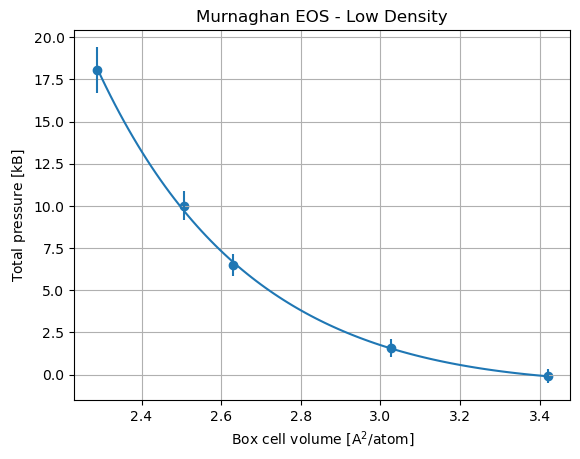

The fitted value of the volume is:  3.3732891607513134
The error associated to the volume is:  0.14983542084452803


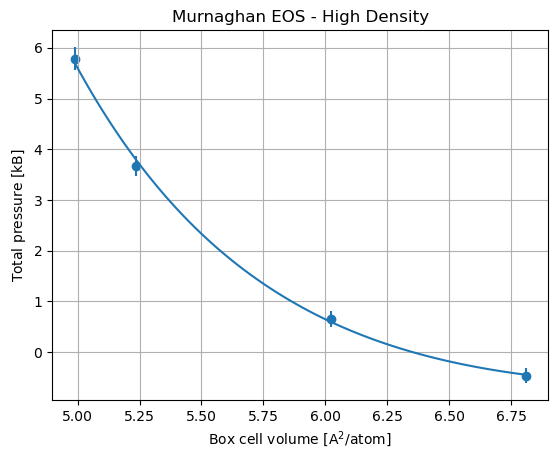

The fitted value of the volume is:  6.351849343987393
The error associated to the volume is:  0.08191878680108086


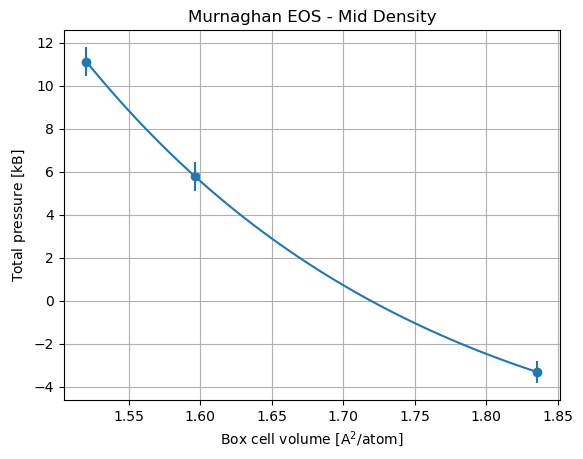

The fitted value of the volume is:  1.7192984796799218
The error associated to the volume is:  0.02076238141740945


In [6]:
#Curvefit method
from scipy.optimize import curve_fit

#Automated curvefitting
#Third-order Birch-Murnaghan Equation of State
def func(V, V_0, B_0, B_0_p):
    return (1.5*B_0)*((V_0/V)**(7/3) - (V_0/V)**(5/3))*(1 + (3/4)*(B_0_p - 4)*(((V_0/V)**(2/3))-1))

#Fit the curves
#Low Density
Vols_LD = [2.287715184, 2.5055915040038176, 2.6308709812104476, 3.025501629, 3.4201]
coefs = curve_fit(func, Vols_LD, press[:5], sigma = pres_ci[:5], p0 = [2.631, 1, 1], absolute_sigma = True)
#Plot the curve
P_func_LD = func(np.linspace(Vols_LD[0], Vols_LD[-1], 100), coefs[0][0], coefs[0][1], coefs[0][2])
#Plot the pressures one
plt.figure()
plt.scatter(Vols_LD, press[:5],)
plt.errorbar(Vols_LD, press[:5],yerr = pres_ci[:5], fmt = 'none')
plt.plot(np.linspace(Vols_LD[0], Vols_LD[-1], 100), P_func_LD)
plt.title('Murnaghan EOS - Low Density')
plt.xlabel(r'Box cell volume $\mathrm{[A^{2}/atom]}$')
plt.ylabel(r'Total pressure $\mathrm{[kB]}$')
plt.grid()
plt.show()
print('The fitted value of the volume is: ', coefs[0][0])
print('The error associated to the volume is: ', np.sqrt(coefs[1][0][0]))

#High Density
Vols_HD = [4.988283151254265, 5.237697321417083, 6.023351928537083, 6.808952248]
coefs = curve_fit(func, Vols_HD, press[5:9], sigma = pres_ci[5:9], p0 = [6, 20, 12], absolute_sigma = True)
#Plot the curve
P_func_HD = func(np.linspace(Vols_HD[0], Vols_HD[-1], 100), coefs[0][0], coefs[0][1], coefs[0][2])
#Plot the pressures one
plt.figure()
plt.scatter(Vols_HD, press[5:9],)
plt.errorbar(Vols_HD, press[5:9],yerr = pres_ci[5:9], fmt = 'none')
plt.plot(np.linspace(Vols_HD[0], Vols_HD[-1], 100), P_func_HD)
plt.title('Murnaghan EOS - High Density')
plt.xlabel(r'Box cell volume $\mathrm{[A^{2}/atom]}$')
plt.ylabel(r'Total pressure $\mathrm{[kB]}$')
plt.grid()
plt.show()
print('The fitted value of the volume is: ', coefs[0][0])
print('The error associated to the volume is: ', np.sqrt(coefs[1][0][0]))

#Mid Density
Vols_MD = [1.520281143, 1.59629509, 1.83573934]
coefs = curve_fit(func, Vols_MD, press[9:12], sigma = pres_ci[9:12], p0 = [1.7, 62, 6.18], absolute_sigma = True)
#Plot the curve
P_func_MD = func(np.linspace(Vols_MD[0], Vols_MD[-1], 100), coefs[0][0], coefs[0][1], coefs[0][2])
#Plot the pressures one
plt.figure()
plt.scatter(Vols_MD, press[9:12],)
plt.errorbar(Vols_MD, press[9:12],yerr = pres_ci[9:12], fmt = 'none')
plt.plot(np.linspace(Vols_MD[0], Vols_MD[-1], 100), P_func_MD)
plt.title('Murnaghan EOS - Mid Density')
plt.xlabel(r'Box cell volume $\mathrm{[A^{2}/atom]}$')
plt.ylabel(r'Total pressure $\mathrm{[kB]}$')
plt.grid()
plt.show()
print('The fitted value of the volume is: ', coefs[0][0])
print('The error associated to the volume is: ', np.sqrt(coefs[1][0][0]))


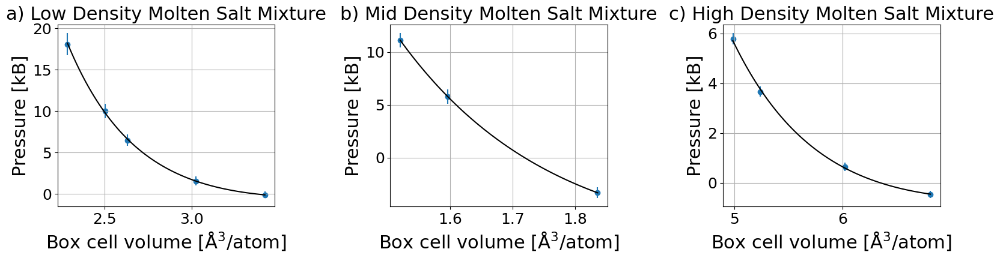

In [20]:
import matplotlib as mpl
fig, ax = plt.subplots(nrows=1, ncols=3,figsize = (16, 4))
fig.tight_layout(h_pad = 3.6, w_pad = 4.6) 
font = {
        'weight' : 'normal',
        'size'   : 18}
mpl.rc('font', **font)

#Low Density
#ax[1, 0].title.set_text('a) $\mathrm{NaF-LiF-ZrF_{4}}$ - No Transfer Learning', )
ax[0].title.set_weight(weight = 'normal')
ax[0].title.set_fontsize('x-large')

ax[0].scatter(Vols_LD, press[:5], label = 'Reference values')
ax[0].errorbar(Vols_LD, press[:5],yerr = pres_ci[:5], fmt = 'none')

ax[0].plot(np.linspace(Vols_LD[0], Vols_LD[-1], 100), P_func_LD, label = 'NN (1123 K)', color = 'k')
ax[0].grid()
ax[0].set_title('a) Low Density Molten Salt Mixture', fontsize=22,)
ax[0].set_xlabel('Box cell volume $[\mathrm{\AA^{3}/atom}]$', fontsize=22,)
#ax[1, 0].legend(loc='lower right', fontsize="16", )#bbox_to_anchor=(1.8, 0))
ax[0].set_ylabel('Pressure [kB]',  fontsize=22,)

#Mid Density
#ax[1, 2].title.set_text('a) $\mathrm{NaF-LiF-ZrF_{4}}$ - No Transfer Learning', )
ax[1].title.set_weight(weight = 'normal')
ax[1].title.set_fontsize('x-large')

ax[1].scatter(Vols_MD, press[9:12], label = 'Reference values')
ax[1].errorbar(Vols_MD, press[9:12],yerr = pres_ci[9:12], fmt = 'none')

ax[1].plot(np.linspace(Vols_MD[0], Vols_MD[-1], 100), P_func_MD, label = 'NN (1123 K)', color = 'k')
ax[1].grid()
ax[1].set_title('b) Mid Density Molten Salt Mixture', fontsize=22,)
ax[1].set_xlabel('Box cell volume $[\mathrm{\AA^{3}/atom}]$', fontsize=22,)
#ax[1, 2].legend(loc='lower right', fontsize="16", )#bbox_to_anchor=(1.8, 0))
ax[1].set_ylabel('Pressure [kB]',  fontsize=22,)

#High Density
#ax[1, 1].title.set_text('a) $\mathrm{NaF-LiF-ZrF_{4}}$ - No Transfer Learning', )
ax[2].title.set_weight(weight = 'normal')
ax[2].title.set_fontsize('x-large')

ax[2].scatter(Vols_HD, press[5:9], label = 'Reference values')
ax[2].errorbar(Vols_HD, press[5:9],yerr = pres_ci[5:9], fmt = 'none')

ax[2].plot(np.linspace(Vols_HD[0], Vols_HD[-1], 100), P_func_HD, label = 'NN (1123 K)', color = 'k')
ax[2].grid()
ax[2].set_title('c) High Density Molten Salt Mixture', fontsize=22,)
ax[2].set_xlabel('Box cell volume $[\mathrm{\AA^{3}/atom}]$', fontsize=22,)
#ax[1, 1].legend(loc='lower right', fontsize="16", )#bbox_to_anchor=(1.8, 0))
ax[2].set_ylabel('Pressure [kB]',  fontsize=22,)

plt.show()

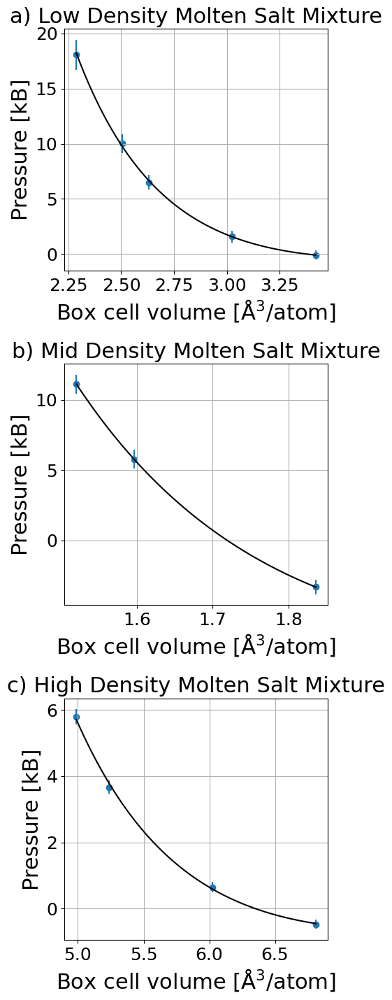

In [16]:
import matplotlib as mpl
fig, ax = plt.subplots(nrows=3, ncols=1,figsize = (5, 14))
fig.tight_layout(h_pad = 3.6, w_pad = 4.6) 
font = {
        'weight' : 'normal',
        'size'   : 18}
mpl.rc('font', **font)

#Low Density
#ax[1, 0].title.set_text('a) $\mathrm{NaF-LiF-ZrF_{4}}$ - No Transfer Learning', )
ax[0].title.set_weight(weight = 'normal')
ax[0].title.set_fontsize('x-large')

ax[0].scatter(Vols_LD, press[:5], label = 'Reference values')
ax[0].errorbar(Vols_LD, press[:5],yerr = pres_ci[:5], fmt = 'none')

ax[0].plot(np.linspace(Vols_LD[0], Vols_LD[-1], 100), P_func_LD, label = 'NN (1123 K)', color = 'k')
ax[0].grid()
ax[0].set_title('a) Low Density Molten Salt Mixture', fontsize=22,)
ax[0].set_xlabel('Box cell volume $[\mathrm{\AA^{3}/atom}]$', fontsize=22,)
#ax[1, 0].legend(loc='lower right', fontsize="16", )#bbox_to_anchor=(1.8, 0))
ax[0].set_ylabel('Pressure [kB]',  fontsize=22,)

#Mid Density
#ax[1, 2].title.set_text('a) $\mathrm{NaF-LiF-ZrF_{4}}$ - No Transfer Learning', )
ax[1].title.set_weight(weight = 'normal')
ax[1].title.set_fontsize('x-large')

ax[1].scatter(Vols_MD, press[9:12], label = 'Reference values')
ax[1].errorbar(Vols_MD, press[9:12],yerr = pres_ci[9:12], fmt = 'none')

ax[1].plot(np.linspace(Vols_MD[0], Vols_MD[-1], 100), P_func_MD, label = 'NN (1123 K)', color = 'k')
ax[1].grid()
ax[1].set_title('b) Mid Density Molten Salt Mixture', fontsize=22,)
ax[1].set_xlabel('Box cell volume $[\mathrm{\AA^{3}/atom}]$', fontsize=22,)
#ax[1, 2].legend(loc='lower right', fontsize="16", )#bbox_to_anchor=(1.8, 0))
ax[1].set_ylabel('Pressure [kB]',  fontsize=22,)

#High Density
#ax[1, 1].title.set_text('a) $\mathrm{NaF-LiF-ZrF_{4}}$ - No Transfer Learning', )
ax[2].title.set_weight(weight = 'normal')
ax[2].title.set_fontsize('x-large')

ax[2].scatter(Vols_HD, press[5:9], label = 'Reference values')
ax[2].errorbar(Vols_HD, press[5:9],yerr = pres_ci[5:9], fmt = 'none')

ax[2].plot(np.linspace(Vols_HD[0], Vols_HD[-1], 100), P_func_HD, label = 'NN (1123 K)', color = 'k')
ax[2].grid()
ax[2].set_title('c) High Density Molten Salt Mixture', fontsize=22,)
ax[2].set_xlabel('Box cell volume $[\mathrm{\AA^{3}/atom}]$', fontsize=22,)
#ax[1, 1].legend(loc='lower right', fontsize="16", )#bbox_to_anchor=(1.8, 0))
ax[2].set_ylabel('Pressure [kB]',  fontsize=22,)

plt.show()

In [9]:
'''
data = np.column_stack([p_std])
datafile_path = "press_uncertainity.txt"
np.savetxt(datafile_path , data)
'''

'\ndata = np.column_stack([p_std])\ndatafile_path = "press_uncertainity.txt"\nnp.savetxt(datafile_path , data)\n'

In [10]:
#From Rajni's code

In [11]:
import numpy as np
import pickle
import os
import matplotlib.pyplot as plt
from scipy.stats import sem
import scipy.stats as stats
import math
from lmfit import Model
from pymatgen.core.periodic_table import Element
from scipy import constants as const
from matplotlib import rc

# LD

[[Model]]
    Model(BM_EOS)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 74
    # data points      = 5
    # variables        = 3
    chi-square         = 0.25880093
    reduced chi-square = 0.12940047
    Akaike info crit   = -8.80567010
    Bayesian info crit = -9.97735636
    R-squared          = 0.99937917
[[Variables]]
    B0:   7.82568139 +/- 1.26800387 (16.20%) (init = 1)
    B0P:  11.8966815 +/- 1.91376336 (16.09%) (init = 1)
    V0:   3.37401136 +/- 0.02295521 (0.68%) (init = 1.7)
[[Correlations]] (unreported correlations are < 0.100)
    C(B0, B0P) = -0.9478
    C(B0, V0)  = -0.6583
    C(B0P, V0) = +0.4010


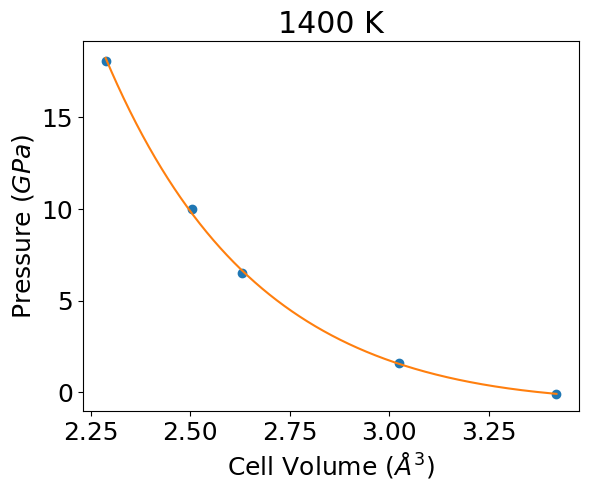

In [12]:
def get_data(plot=True):
    z_critical = stats.norm.ppf(q = 0.95)
    
    # CaF2-MgF2_50-50_1400K, AIMD DFT-D3
    vol = Vols_LD #(in cubic Angstrom)
    pres = press[:5] #(in GPa)
    pres_std = pres_ci[:5] #(in GPa)

    return vol, pres, pres_std

def BM_EOS(V, B0, B0P, V0):
    # """From Wikipedia
    # """
    P = 3/2 * B0 * ((V0/V)**(7/3) - (V0/V)**(5/3))*(1 + (3/4) * (B0P-4) * ((V0/V)**(2/3) - 1))
    # return P
    # P = B0/B0P * ((V/V0)**(-B0P) - 1)
    return P
    
def fit_data():
    vol, pres, pres_std = get_data()
    bm_model = Model(BM_EOS)
    params = bm_model.make_params(B0=1, B0P=1, V0=1.700)
    # result = bm_model.fit(data=pres, params=params, V=vol)
    result = bm_model.fit(data=pres, params=params, V=vol, weights=1/np.square(np.array(pres_std)))
    plt.plot(vol, pres, 'o')
    vol_fit = np.linspace(vol[0], vol[-1], 1000)
    pfit = BM_EOS(vol_fit, result.params['B0'].value, result.params['B0P'].value,
     result.params['V0'].value)
    print(result.fit_report())
    # calculate the density and the bulk modulus
    volume = result.params['V0'].value

    from scipy.stats import t
    # confidence interval for the 95% interval
    ci_v0 = result.params['V0'].stderr*t.ppf(0.975, df=len(pres)-1)

    bulk = np.round(result.params['B0'].value)/10
    bulk_std = np.round(result.params['B0'].stderr)/10
    plt.plot(vol_fit, pfit)
    # plt.errorbar(vol_fit, pfit, pres_std, marker='o', capsize=5, fmt='s')
    plt.ylabel('Pressure ($GPa$)')
    plt.xlabel('Cell Volume ($\AA^3$)')
    plt.title('1400 K')
    #plt.legend('Birch Murnaghan EOS')
    plt.savefig('BM_EOS_MgF2-CaF2_1400k_aimd.png')
    plt.show()

if __name__ == '__main__':
    fit_data()

# MD

[[Model]]
    Model(BM_EOS)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 29
    # data points      = 3
    # variables        = 3
    chi-square         = 1.3430e-25
    reduced chi-square = 1.3430e-25
    Akaike info crit   = -169.104918
    Bayesian info crit = -171.809081
    R-squared          = 1.00000000
[[Variables]]
    B0:   62.0070041 +/- 1.1315e-12 (0.00%) (init = 45)
    B0P:  6.17949834 +/- 8.2660e-13 (0.00%) (init = 5)
    V0:   1.71929848 +/- 5.0340e-15 (0.00%) (init = 2.6)
[[Correlations]] (unreported correlations are < 0.100)
    C(B0P, V0) = -0.9008
    C(B0, B0P) = -0.4973
    C(B0, V0)  = +0.2039


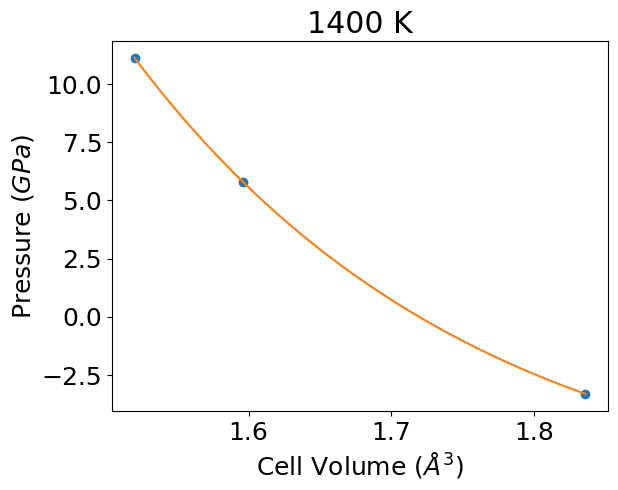

In [13]:
def get_data(plot=True):
    z_critical = stats.norm.ppf(q = 0.95)
    
    # CaF2-MgF2_50-50_1400K, AIMD DFT-D3
    vol = Vols_MD #(in cubic Angstrom)
    pres = press[9:12] #(in GPa)
    pres_std = pres_ci[9:12] #(in GPa)

    return vol, pres, pres_std

def BM_EOS(V, B0, B0P, V0):
    # """From Wikipedia
    # """
    P = 3/2 * B0 * ((V0/V)**(7/3) - (V0/V)**(5/3))*(1 + (3/4) * (B0P-4) * ((V0/V)**(2/3) - 1))
    # return P
    # P = B0/B0P * ((V/V0)**(-B0P) - 1)
    return P
    
def fit_data():
    vol, pres, pres_std = get_data()
    bm_model = Model(BM_EOS)
    params = bm_model.make_params(B0=45, B0P=5, V0=2.600)
    # result = bm_model.fit(data=pres, params=params, V=vol)
    result = bm_model.fit(data=pres, params=params, V=vol, weights=1/np.square(np.array(pres_std)))
    plt.plot(vol, pres, 'o')
    vol_fit = np.linspace(vol[0], vol[-1], 1000)
    pfit = BM_EOS(vol_fit, result.params['B0'].value, result.params['B0P'].value,
     result.params['V0'].value)
    print(result.fit_report())
    # calculate the density and the bulk modulus
    volume = result.params['V0'].value

    from scipy.stats import t
    # confidence interval for the 95% interval
    ci_v0 = result.params['V0'].stderr*t.ppf(0.975, df=len(pres)-1)

    bulk = np.round(result.params['B0'].value)/10
    bulk_std = np.round(result.params['B0'].stderr)/10
    plt.plot(vol_fit, pfit)
    # plt.errorbar(vol_fit, pfit, pres_std, marker='o', capsize=5, fmt='s')
    plt.ylabel('Pressure ($GPa$)')
    plt.xlabel('Cell Volume ($\AA^3$)')
    plt.title('1400 K')
    #plt.legend('Birch Murnaghan EOS')
    plt.savefig('BM_EOS_MgF2-CaF2_1400k_aimd.png')
    plt.show()

if __name__ == '__main__':
    fit_data()

# HD

[[Model]]
    Model(BM_EOS)
[[Fit Statistics]]
    # fitting method   = leastsq
    # function evals   = 25
    # data points      = 4
    # variables        = 3
    chi-square         = 15.3433927
    reduced chi-square = 15.3433927
    Akaike info crit   = 11.3775623
    Bayesian info crit = 9.53644540
    R-squared          = 0.99889745
[[Variables]]
    B0:   9.01444830 +/- 0.95781514 (10.63%) (init = 45)
    B0P:  8.52804268 +/- 1.44614936 (16.96%) (init = 5)
    V0:   6.35833903 +/- 0.05087192 (0.80%) (init = 5)
[[Correlations]] (unreported correlations are < 0.100)
    C(B0, B0P) = -0.7777
    C(B0P, V0) = -0.3604
    C(B0, V0)  = -0.2587


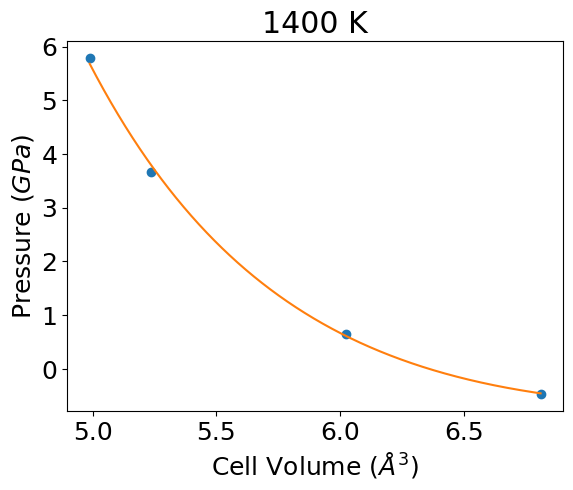

In [14]:
def get_data(plot=True):
    z_critical = stats.norm.ppf(q = 0.95)
    
    # CaF2-MgF2_50-50_1400K, AIMD DFT-D3
    vol = Vols_HD #(in cubic Angstrom)
    pres = press[5:9] #(in GPa)
    pres_std = pres_ci[5:9] #(in GPa)

    return vol, pres, pres_std

def BM_EOS(V, B0, B0P, V0):
    # """From Wikipedia
    # """
    P = 3/2 * B0 * ((V0/V)**(7/3) - (V0/V)**(5/3))*(1 + (3/4) * (B0P-4) * ((V0/V)**(2/3) - 1))
    # return P
    # P = B0/B0P * ((V/V0)**(-B0P) - 1)
    return P
    
def fit_data():
    vol, pres, pres_std = get_data()
    bm_model = Model(BM_EOS)
    params = bm_model.make_params(B0=45, B0P=5, V0=5)
    # result = bm_model.fit(data=pres, params=params, V=vol)
    result = bm_model.fit(data=pres, params=params, V=vol, weights=1/np.square(np.array(pres_std)))
    plt.plot(vol, pres, 'o')
    vol_fit = np.linspace(vol[0], vol[-1], 1000)
    pfit = BM_EOS(vol_fit, result.params['B0'].value, result.params['B0P'].value,
     result.params['V0'].value)
    print(result.fit_report())
    # calculate the density and the bulk modulus
    volume = result.params['V0'].value

    from scipy.stats import t
    # confidence interval for the 95% interval
    ci_v0 = result.params['V0'].stderr*t.ppf(0.975, df=len(pres)-1)

    bulk = np.round(result.params['B0'].value)/10
    bulk_std = np.round(result.params['B0'].stderr)/10
    plt.plot(vol_fit, pfit)
    # plt.errorbar(vol_fit, pfit, pres_std, marker='o', capsize=5, fmt='s')
    plt.ylabel('Pressure ($GPa$)')
    plt.xlabel('Cell Volume ($\AA^3$)')
    plt.title('1400 K')
    #plt.legend('Birch Murnaghan EOS')
    plt.savefig('BM_EOS_MgF2-CaF2_1400k_aimd.png')
    plt.show()

if __name__ == '__main__':
    fit_data()